<a href="https://colab.research.google.com/github/richarn/Actividad/blob/master/treinocell.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [3]:
pip install ultralytics


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 904.3/904.3 kB 27.4 MB/s eta 0:00:00


In [5]:
from google.colab import drive
drive.mount('/content/drive')


Mounted at /content/drive


In [39]:
# Verificar acceso al dataset
!ls '/content/drive/My Drive/microscopy/Yolo/'

img.jpg  README.dataset.txt  README.roboflow.txt  train  valid	yolov8n.pt


In [26]:
!ls '/content/drive/My Drive/microscopy/Yolo/train/images' | head -n 5
!ls '/content/drive/My Drive/microscopy/Yolo/train/labels' | head -n 5
!ls '/content/drive/My Drive/microscopy/Yolo/valid/images' | head -n 5
!ls '/content/drive/My Drive/microscopy/Yolo/valid/labels' | head -n 5

1__jpg.rf.7c7126359ac29f661a74a80538b240ca.jpg
3-_jpg.rf.8c814e9d9d5cb7a191ba34a4025a8a47.jpg
4__jpg.rf.9c5ec71cdee80092d21bfa7b322fb44a.jpg
1__jpg.rf.7c7126359ac29f661a74a80538b240ca.txt
3-_jpg.rf.8c814e9d9d5cb7a191ba34a4025a8a47.txt
4__jpg.rf.9c5ec71cdee80092d21bfa7b322fb44a.txt
5__jpg.rf.e7019ecde444aa1557da6a4e5bdd0149.jpg
5__jpg.rf.e7019ecde444aa1557da6a4e5bdd0149.txt


In [40]:
# Definir la ruta base del dataset
dataset_path = '/content/drive/My Drive/microscopy/Yolo'

# Contenido del archivo YAML con formato válido
yaml_content = """
path: /content/drive/My Drive/microscopy/Yolo
train: train/images
val: valid/images

names:
  0: membrana
  1: núcleo
  2: nucleolo
"""


# Ruta para guardar el archivo YAML
yaml_file_path = f"{dataset_path}/data.yaml"

# Crear el archivo YAML
with open(yaml_file_path, 'w') as f:
    f.write(yaml_content.strip())  # Usar .strip() para eliminar saltos de línea extra al inicio y al final

print(f"Archivo 'data.yaml' creado correctamente en: {yaml_file_path}")
!cat "{yaml_file_path}"


Archivo 'data.yaml' creado correctamente en: /content/drive/My Drive/microscopy/Yolo/data.yaml
path: /content/drive/My Drive/microscopy/Yolo
train: train/images
val: valid/images

names:
  0: membrana
  1: núcleo
  2: nucleolo

In [41]:
!ls '/content/drive/My Drive/microscopy/Yolo/'

data.yaml  img.jpg  README.dataset.txt	README.roboflow.txt  train  valid  yolov8n.pt


#Entrenar el modelo

In [43]:
from ultralytics import YOLO

# Cargar el modelo YOLOv8
model = YOLO('yolov8s.pt')  # Cambia a 'yolov8s.pt' para más precisión si lo deseas

# Entrenar el modelo
model.train(
    data=f"{dataset_path}/data.yaml",  # Ruta completa al archivo YAML
    epochs=100,
    imgsz=640,
    batch=16,
    device='cpu'  # Cambia a 'cuda' si tienes GPU disponible
)


100%|██████████| 21.5M/21.5M [00:00<00:00, 102MB/s] 

Ultralytics 8.3.55 🚀 Python-3.10.12 torch-2.5.1+cu121 CPU (Intel Xeon 2.00GHz)


engine/trainer: task=detect, mode=train, model=yolov8s.pt, data=/content/drive/My Drive/microscopy/Yolo/data.yaml, epochs=100, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=cpu, workers=8, project=None, name=train14, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, show_boxes=True, line_width=None, format=torchscript, keras=False, 

train: Scanning /content/drive/My Drive/microscopy/Yolo/train/labels.cache... 3 images, 0 backgrounds, 0 corrupt: 100%|██████████| 3/3 [00:00<?, ?it/s]

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))



val: Scanning /content/drive/My Drive/microscopy/Yolo/valid/labels.cache... 1 images, 0 backgrounds, 0 corrupt: 100%|██████████| 1/1 [00:00<?, ?it/s]

Plotting labels to runs/detect/train14/labels.jpg... 


optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001429, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 0 dataloader workers
Logging results to runs/detect/train14
Starting training for 100 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      1/100         0G      1.381      5.059      1.336         23        640: 100%|██████████| 1/1 [00:04<00:00,  4.89s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.37it/s]

                   all          1          3          0          0          0          0



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      2/100         0G      1.273      4.601      1.292         37        640: 100%|██████████| 1/1 [00:04<00:00,  4.96s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.07it/s]

                   all          1          3          0          0          0          0



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      3/100         0G       1.22      4.188      1.309         24        640: 100%|██████████| 1/1 [00:04<00:00,  4.00s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.02it/s]

                   all          1          3          0          0          0          0



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      4/100         0G      1.575      4.493      1.394         60        640: 100%|██████████| 1/1 [00:05<00:00,  5.17s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.44it/s]

                   all          1          3          0          0          0          0



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      5/100         0G       1.12      3.753      1.156         37        640: 100%|██████████| 1/1 [00:03<00:00,  3.94s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.03it/s]

                   all          1          3          0          0          0          0



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      6/100         0G      1.632      4.242      1.418         26        640: 100%|██████████| 1/1 [00:03<00:00,  3.88s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.65it/s]

                   all          1          3          0          0          0          0



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      7/100         0G      1.645       3.48       1.28         47        640: 100%|██████████| 1/1 [00:05<00:00,  5.07s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.05it/s]

                   all          1          3     0.0041        0.5    0.00425    0.00255



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      8/100         0G      1.407      3.284      1.251         44        640: 100%|██████████| 1/1 [00:03<00:00,  3.89s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.00it/s]

                   all          1          3      0.005        0.5    0.00843    0.00582



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      9/100         0G      1.007      2.332      1.029         23        640: 100%|██████████| 1/1 [00:04<00:00,  4.62s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.27it/s]

                   all          1          3    0.00978        0.5     0.0113    0.00905



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     10/100         0G     0.6781      1.678     0.9258         37        640: 100%|██████████| 1/1 [00:03<00:00,  3.97s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.87it/s]

                   all          1          3     0.0112        0.5     0.0121     0.0109



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     11/100         0G      1.068      2.746      1.045         21        640: 100%|██████████| 1/1 [00:03<00:00,  3.89s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.80it/s]

                   all          1          3      0.015        0.5     0.0166     0.0133



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     12/100         0G      1.399      1.896      1.077         61        640: 100%|██████████| 1/1 [00:05<00:00,  5.28s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.89it/s]

                   all          1          3     0.0166        0.5     0.0184     0.0166



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     13/100         0G      1.077      1.883     0.9472         51        640: 100%|██████████| 1/1 [00:03<00:00,  3.91s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.99it/s]

                   all          1          3     0.0077        0.5    0.00995    0.00895



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     14/100         0G      0.679      2.245     0.9331         24        640: 100%|██████████| 1/1 [00:04<00:00,  4.50s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.37it/s]

                   all          1          3    0.00491        0.5     0.0063    0.00504



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     15/100         0G     0.8286      1.377     0.8731         29        640: 100%|██████████| 1/1 [00:04<00:00,  4.17s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.89it/s]

                   all          1          3    0.00639        0.5     0.0079    0.00632



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     16/100         0G     0.8513      1.241     0.9174         42        640: 100%|██████████| 1/1 [00:03<00:00,  3.85s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.96it/s]

                   all          1          3       0.02        0.5     0.0226     0.0181



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     17/100         0G     0.7809      1.038     0.8872         28        640: 100%|██████████| 1/1 [00:05<00:00,  5.30s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.60it/s]

                   all          1          3     0.0222        0.5     0.0262     0.0209



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     18/100         0G      0.948      1.446     0.9032         30        640: 100%|██████████| 1/1 [00:03<00:00,  3.72s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.98it/s]

                   all          1          3     0.0222        0.5     0.0262     0.0209



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     19/100         0G     0.8193       1.52     0.9373         19        640: 100%|██████████| 1/1 [00:03<00:00,  3.79s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.42it/s]

                   all          1          3      0.025        0.5     0.0262     0.0209



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     20/100         0G     0.9138      1.257     0.9216         88        640: 100%|██████████| 1/1 [00:04<00:00,  4.73s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.02it/s]

                   all          1          3      0.025        0.5     0.0262     0.0209



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     21/100         0G     0.8642      1.115     0.8678         50        640: 100%|██████████| 1/1 [00:03<00:00,  3.98s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.10it/s]

                   all          1          3      0.524        0.5     0.0262     0.0209



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     22/100         0G      1.172      1.095     0.9724         29        640: 100%|██████████| 1/1 [00:04<00:00,  4.56s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.43it/s]

                   all          1          3      0.524        0.5     0.0262     0.0209



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     23/100         0G      1.064      1.327     0.9818         39        640: 100%|██████████| 1/1 [00:03<00:00,  3.90s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.14it/s]

                   all          1          3      0.522        0.5     0.0237      0.019



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     24/100         0G     0.7112      1.049     0.8359         34        640: 100%|██████████| 1/1 [00:03<00:00,  3.74s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.21it/s]

                   all          1          3      0.522        0.5     0.0237      0.019



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     25/100         0G     0.9379      1.297     0.8695         25        640: 100%|██████████| 1/1 [00:05<00:00,  5.37s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.22it/s]

                   all          1          3      0.515        0.5     0.0226     0.0181



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     26/100         0G     0.7695      1.098     0.8319         36        640: 100%|██████████| 1/1 [00:03<00:00,  3.79s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.22it/s]

                   all          1          3      0.515        0.5     0.0226     0.0181



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     27/100         0G      1.044      1.463     0.8922         64        640: 100%|██████████| 1/1 [00:04<00:00,  4.10s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.53it/s]

                   all          1          3      0.518        0.5     0.0199     0.0179



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     28/100         0G     0.8559      1.308     0.9442         39        640: 100%|██████████| 1/1 [00:04<00:00,  4.63s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.14it/s]

                   all          1          3      0.518        0.5     0.0199     0.0179



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     29/100         0G     0.8124     0.7928     0.8623         43        640: 100%|██████████| 1/1 [00:03<00:00,  3.87s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.23it/s]

                   all          1          3      0.518        0.5     0.0184     0.0166



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     30/100         0G     0.7147      1.143     0.8993         28        640: 100%|██████████| 1/1 [00:04<00:00,  4.49s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.44it/s]

                   all          1          3      0.518        0.5     0.0184     0.0166



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     31/100         0G     0.8097      1.211     0.8735         55        640: 100%|██████████| 1/1 [00:04<00:00,  4.14s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.24it/s]

                   all          1          3      0.518        0.5     0.0199     0.0179



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     32/100         0G      1.084      2.328     0.9182         24        640: 100%|██████████| 1/1 [00:03<00:00,  3.73s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.05it/s]

                   all          1          3      0.518        0.5     0.0199     0.0179



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     33/100         0G     0.6495      1.097     0.8852         45        640: 100%|██████████| 1/1 [00:05<00:00,  5.35s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.93it/s]

                   all          1          3      0.521        0.5     0.0216     0.0173



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     34/100         0G     0.8311      1.104     0.9294         38        640: 100%|██████████| 1/1 [00:03<00:00,  3.77s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.18it/s]

                   all          1          3      0.521        0.5     0.0216     0.0173



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     35/100         0G     0.7562     0.8171     0.8712         58        640: 100%|██████████| 1/1 [00:03<00:00,  3.95s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.55it/s]

                   all          1          3       0.52        0.5     0.0237      0.019



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     36/100         0G      1.226      1.173     0.9315         52        640: 100%|██████████| 1/1 [00:04<00:00,  4.79s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.28it/s]

                   all          1          3       0.52        0.5     0.0237      0.019



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     37/100         0G     0.8886      1.064     0.9797         19        640: 100%|██████████| 1/1 [00:03<00:00,  3.84s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.25it/s]

                   all          1          3    0.00476        0.5     0.0207     0.0187



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     38/100         0G     0.9365      1.101     0.8557         72        640: 100%|██████████| 1/1 [00:04<00:00,  4.37s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.57it/s]

                   all          1          3    0.00476        0.5     0.0207     0.0187



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     39/100         0G     0.8456       1.11     0.8849         38        640: 100%|██████████| 1/1 [00:04<00:00,  4.36s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.23it/s]

                   all          1          3    0.00532        0.5      0.016     0.0144



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     40/100         0G     0.6792     0.7915     0.8591         41        640: 100%|██████████| 1/1 [00:03<00:00,  3.75s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.16it/s]

                   all          1          3    0.00532        0.5      0.016     0.0144



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     41/100         0G     0.6368     0.8849     0.8661         17        640: 100%|██████████| 1/1 [00:05<00:00,  5.19s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.53it/s]

                   all          1          3    0.00417        0.5     0.0207     0.0187



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     42/100         0G     0.8572      1.573     0.8058          9        640: 100%|██████████| 1/1 [00:03<00:00,  3.74s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.25it/s]

                   all          1          3    0.00417        0.5     0.0207     0.0187



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     43/100         0G     0.5666     0.7379     0.9279         27        640: 100%|██████████| 1/1 [00:04<00:00,  4.00s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.31it/s]

                   all          1          3    0.00296        0.5     0.0199     0.0159



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     44/100         0G     0.9023     0.9796     0.8927         31        640: 100%|██████████| 1/1 [00:05<00:00,  5.08s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.27it/s]

                   all          1          3    0.00296        0.5     0.0199     0.0159



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     45/100         0G     0.5775     0.5931     0.8056         31        640: 100%|██████████| 1/1 [00:03<00:00,  3.92s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.23it/s]

                   all          1          3    0.00248        0.5     0.0191     0.0153



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     46/100         0G     0.8758      1.033     0.8973         29        640: 100%|██████████| 1/1 [00:04<00:00,  4.11s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.57it/s]

                   all          1          3    0.00248        0.5     0.0191     0.0153



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     47/100         0G     0.8576     0.8388     0.8647         44        640: 100%|██████████| 1/1 [00:04<00:00,  4.32s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.09it/s]

                   all          1          3    0.00243        0.5     0.0332     0.0298



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     48/100         0G     0.6532     0.6863     0.8552         44        640: 100%|██████████| 1/1 [00:03<00:00,  3.75s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.30it/s]

                   all          1          3    0.00243        0.5     0.0332     0.0298



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     49/100         0G     0.9648     0.8617     0.8852         73        640: 100%|██████████| 1/1 [00:05<00:00,  5.27s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.53it/s]

                   all          1          3      0.546        0.5     0.0553     0.0498



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     50/100         0G      0.626     0.5363     0.8302         49        640: 100%|██████████| 1/1 [00:03<00:00,  3.79s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.22it/s]

                   all          1          3      0.546        0.5     0.0553     0.0498



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     51/100         0G      0.704     0.7205     0.9219         28        640: 100%|██████████| 1/1 [00:03<00:00,  3.83s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.11it/s]

                   all          1          3      0.598       0.49     0.0995     0.0895



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     52/100         0G     0.6747     0.6166     0.8507         46        640: 100%|██████████| 1/1 [00:04<00:00,  4.82s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.23it/s]

                   all          1          3      0.598       0.49     0.0995     0.0895



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     53/100         0G     0.8649     0.8055     0.8812         29        640: 100%|██████████| 1/1 [00:03<00:00,  3.83s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.24it/s]

                   all          1          3      0.598       0.49     0.0995     0.0895



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     54/100         0G     0.7089     0.7897     0.8598         33        640: 100%|██████████| 1/1 [00:04<00:00,  4.40s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.56it/s]

                   all          1          3      0.594        0.5     0.0995     0.0895



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     55/100         0G     0.7033      0.901     0.8514         36        640: 100%|██████████| 1/1 [00:03<00:00,  3.94s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.33it/s]

                   all          1          3      0.594        0.5     0.0995     0.0895



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     56/100         0G     0.7158     0.7869     0.9163         25        640: 100%|██████████| 1/1 [00:03<00:00,  3.81s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.26it/s]

                   all          1          3      0.594        0.5     0.0995     0.0895



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     57/100         0G      0.613     0.7626     0.8275         20        640: 100%|██████████| 1/1 [00:05<00:00,  5.22s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.83it/s]

                   all          1          3      0.564        0.5     0.0995     0.0895



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     58/100         0G       0.63     0.6309     0.8826         39        640: 100%|██████████| 1/1 [00:03<00:00,  3.80s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.24it/s]

                   all          1          3      0.564        0.5     0.0995     0.0895



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     59/100         0G     0.6306     0.7309     0.8702         23        640: 100%|██████████| 1/1 [00:03<00:00,  3.69s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.72it/s]

                   all          1          3      0.564        0.5     0.0995     0.0895



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     60/100         0G      0.873     0.8826     0.8856         76        640: 100%|██████████| 1/1 [00:05<00:00,  5.07s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.21it/s]

                   all          1          3      0.513        0.5     0.0829     0.0746



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     61/100         0G     0.5621        0.6     0.8347         23        640: 100%|██████████| 1/1 [00:03<00:00,  3.72s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.21it/s]

                   all          1          3      0.513        0.5     0.0829     0.0746



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     62/100         0G     0.6212     0.6601     0.8386         63        640: 100%|██████████| 1/1 [00:04<00:00,  4.62s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.50it/s]

                   all          1          3      0.513        0.5     0.0829     0.0746



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     63/100         0G     0.8879     0.8076     0.8944         57        640: 100%|██████████| 1/1 [00:04<00:00,  4.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.07it/s]

                   all          1          3    0.00355        0.5     0.0711      0.064



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     64/100         0G     0.8971     0.9542     0.9113         34        640: 100%|██████████| 1/1 [00:03<00:00,  3.68s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.22it/s]

                   all          1          3    0.00355        0.5     0.0711      0.064



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     65/100         0G     0.6939     0.5677     0.7974         58        640: 100%|██████████| 1/1 [00:05<00:00,  5.20s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.65it/s]

                   all          1          3    0.00355        0.5     0.0711      0.064



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     66/100         0G     0.7698     0.9231     0.8179         10        640: 100%|██████████| 1/1 [00:03<00:00,  3.79s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.23it/s]

                   all          1          3      0.528        0.5     0.0711      0.064



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     67/100         0G     0.9928     0.8093     0.9016         37        640: 100%|██████████| 1/1 [00:03<00:00,  3.76s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.17it/s]

                   all          1          3      0.528        0.5     0.0711      0.064



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     68/100         0G     0.9996     0.7766     0.8813         53        640: 100%|██████████| 1/1 [00:05<00:00,  5.00s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.19it/s]

                   all          1          3      0.528        0.5     0.0711      0.064



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     69/100         0G     0.6721     0.6199     0.8737         68        640: 100%|██████████| 1/1 [00:03<00:00,  3.94s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.21it/s]

                   all          1          3      0.562        0.5     0.0829     0.0746



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     70/100         0G     0.6329      0.681     0.8749         27        640: 100%|██████████| 1/1 [00:04<00:00,  4.26s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.55it/s]

                   all          1          3      0.562        0.5     0.0829     0.0746



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     71/100         0G     0.7648     0.6369     0.8355         32        640: 100%|██████████| 1/1 [00:04<00:00,  4.26s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.20it/s]

                   all          1          3      0.562        0.5     0.0829     0.0746



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     72/100         0G     0.6991     0.5551     0.8476         57        640: 100%|██████████| 1/1 [00:03<00:00,  3.89s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.14it/s]

                   all          1          3      0.567        0.5     0.0829     0.0746



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     73/100         0G     0.8049     0.6188     0.8632         52        640: 100%|██████████| 1/1 [00:04<00:00,  4.84s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.51it/s]

                   all          1          3      0.567        0.5     0.0829     0.0746



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     74/100         0G     0.8856     0.7446     0.8603         43        640: 100%|██████████| 1/1 [00:03<00:00,  3.78s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.28it/s]

                   all          1          3      0.567        0.5     0.0829     0.0746



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     75/100         0G     0.5936     0.6828     0.8212         33        640: 100%|██████████| 1/1 [00:03<00:00,  3.81s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.26it/s]

                   all          1          3      0.573        0.5     0.0829     0.0746



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     76/100         0G     0.6351      0.597     0.8569         25        640: 100%|██████████| 1/1 [00:05<00:00,  5.13s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.14it/s]

                   all          1          3      0.573        0.5     0.0829     0.0746



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     77/100         0G     0.5832     0.5871     0.8375         58        640: 100%|██████████| 1/1 [00:03<00:00,  3.77s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.24it/s]

                   all          1          3      0.573        0.5     0.0829     0.0746



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     78/100         0G      0.706     0.6998     0.8353         22        640: 100%|██████████| 1/1 [00:03<00:00,  3.92s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.56it/s]

                   all          1          3       0.59        0.5     0.0995     0.0895



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     79/100         0G     0.5112      0.496     0.8221         26        640: 100%|██████████| 1/1 [00:04<00:00,  4.34s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.30it/s]

                   all          1          3       0.59        0.5     0.0995     0.0895



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     80/100         0G     0.8224     0.6604     0.8699         72        640: 100%|██████████| 1/1 [00:03<00:00,  3.76s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.20it/s]

                   all          1          3       0.59        0.5     0.0995     0.0895



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     81/100         0G     0.6408     0.5929     0.8685         82        640: 100%|██████████| 1/1 [00:04<00:00,  4.91s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.56it/s]

                   all          1          3      0.625        0.5      0.124      0.112



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     82/100         0G     0.5582     0.4702     0.8032         44        640: 100%|██████████| 1/1 [00:03<00:00,  3.75s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.21it/s]

                   all          1          3      0.625        0.5      0.124      0.112



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     83/100         0G     0.7127     0.6154     0.8454         60        640: 100%|██████████| 1/1 [00:03<00:00,  3.76s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.28it/s]

                   all          1          3      0.625        0.5      0.124      0.112



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     84/100         0G      1.069     0.9772     0.8768         40        640: 100%|██████████| 1/1 [00:05<00:00,  5.17s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.33it/s]

                   all          1          3      0.621        0.5      0.124      0.112



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     85/100         0G     0.5961     0.5107     0.8464         59        640: 100%|██████████| 1/1 [00:03<00:00,  3.88s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.23it/s]

                   all          1          3      0.621        0.5      0.124      0.112



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     86/100         0G     0.5704     0.5174     0.8281         33        640: 100%|██████████| 1/1 [00:04<00:00,  4.20s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.56it/s]

                   all          1          3      0.621        0.5      0.124      0.112



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     87/100         0G     0.8022     0.6484      0.871         89        640: 100%|██████████| 1/1 [00:04<00:00,  4.23s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.22it/s]

                   all          1          3      0.621        0.5      0.124      0.112



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     88/100         0G     0.5863      0.483     0.7955         46        640: 100%|██████████| 1/1 [00:03<00:00,  3.83s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.14it/s]

                   all          1          3      0.621        0.5      0.124     0.0995



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     89/100         0G      0.703     0.6161     0.8924         38        640: 100%|██████████| 1/1 [00:05<00:00,  5.01s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.47it/s]

                   all          1          3      0.621        0.5      0.124     0.0995



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     90/100         0G     0.6366     0.6583     0.9465         32        640: 100%|██████████| 1/1 [00:03<00:00,  3.75s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.31it/s]

                   all          1          3      0.621        0.5      0.124     0.0995


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     91/100         0G     0.5754     0.5152     0.7933         30        640: 100%|██████████| 1/1 [00:03<00:00,  3.77s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.16it/s]

                   all          1          3      0.621        0.5      0.124     0.0995



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     92/100         0G     0.5625     0.4453     0.7882         30        640: 100%|██████████| 1/1 [00:05<00:00,  5.12s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.18it/s]

                   all          1          3      0.619        0.5      0.124      0.112



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     93/100         0G     0.4908     0.5613     0.8041         30        640: 100%|██████████| 1/1 [00:03<00:00,  3.72s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.23it/s]

                   all          1          3      0.619        0.5      0.124      0.112



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     94/100         0G     0.5644     0.4797      0.771         30        640: 100%|██████████| 1/1 [00:04<00:00,  4.02s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.46it/s]

                   all          1          3      0.619        0.5      0.124      0.112



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     95/100         0G     0.4799     0.4537     0.7987         30        640: 100%|██████████| 1/1 [00:04<00:00,  4.27s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.26it/s]

                   all          1          3      0.619        0.5      0.124      0.112



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     96/100         0G     0.6671      0.609     0.8678         30        640: 100%|██████████| 1/1 [00:03<00:00,  3.84s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.28it/s]

                   all          1          3      0.612        0.5      0.124      0.112



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     97/100         0G     0.5245     0.4224     0.8273         30        640: 100%|██████████| 1/1 [00:04<00:00,  4.81s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.52it/s]

                   all          1          3      0.612        0.5      0.124      0.112



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     98/100         0G     0.5461     0.4781     0.8435         28        640: 100%|██████████| 1/1 [00:03<00:00,  3.79s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.16it/s]

                   all          1          3      0.612        0.5      0.124      0.112



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     99/100         0G     0.5143     0.4907     0.7979         30        640: 100%|██████████| 1/1 [00:03<00:00,  3.74s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.19it/s]

                   all          1          3      0.612        0.5      0.124      0.112



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    100/100         0G     0.6696     0.6413      0.834         27        640: 100%|██████████| 1/1 [00:05<00:00,  5.01s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.27it/s]

                   all          1          3      0.599        0.5      0.124      0.112



100 epochs completed in 0.160 hours.
Optimizer stripped from runs/detect/train14/weights/last.pt, 22.5MB
Optimizer stripped from runs/detect/train14/weights/best.pt, 22.5MB

Validating runs/detect/train14/weights/best.pt...
Ultralytics 8.3.55 🚀 Python-3.10.12 torch-2.5.1+cu121 CPU (Intel Xeon 2.00GHz)
Model summary (fused): 168 layers, 11,126,745 parameters, 0 gradients, 28.4 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.42it/s]


                   all          1          3      0.599        0.5      0.124      0.112
              membrana          1          1      0.198          1      0.249      0.224
              nucleolo          1          2          1          0          0          0
Speed: 2.2ms preprocess, 389.3ms inference, 0.0ms loss, 1.2ms postprocess per image
Results saved to runs/detect/train14


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 2])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7e42259314b0>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
          0.04804

#Evaluar el modelo

In [44]:
results = model.val()
print(results)


Ultralytics 8.3.55 🚀 Python-3.10.12 torch-2.5.1+cu121 CPU (Intel Xeon 2.00GHz)
Model summary (fused): 168 layers, 11,126,745 parameters, 0 gradients, 28.4 GFLOPs


val: Scanning /content/drive/My Drive/microscopy/Yolo/valid/labels.cache... 1 images, 0 backgrounds, 0 corrupt: 100%|██████████| 1/1 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.33it/s]


                   all          1          3      0.599        0.5      0.124      0.112
              membrana          1          1      0.198          1      0.249      0.224
              nucleolo          1          2          1          0          0          0
Speed: 2.3ms preprocess, 396.0ms inference, 0.0ms loss, 1.9ms postprocess per image
Results saved to runs/detect/train142
ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 2])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7e42257ada80>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,

#Save the trained model

In [45]:
model.save('trained_model.pt')


#Usar el modelo para inferencias


image 1/1 /content/drive/My Drive/microscopy/Yolo/img.jpg: 544x640 8 membranas, 8 núcleos, 1558.6ms
Speed: 11.0ms preprocess, 1558.6ms inference, 1.4ms postprocess per image at shape (1, 3, 544, 640)


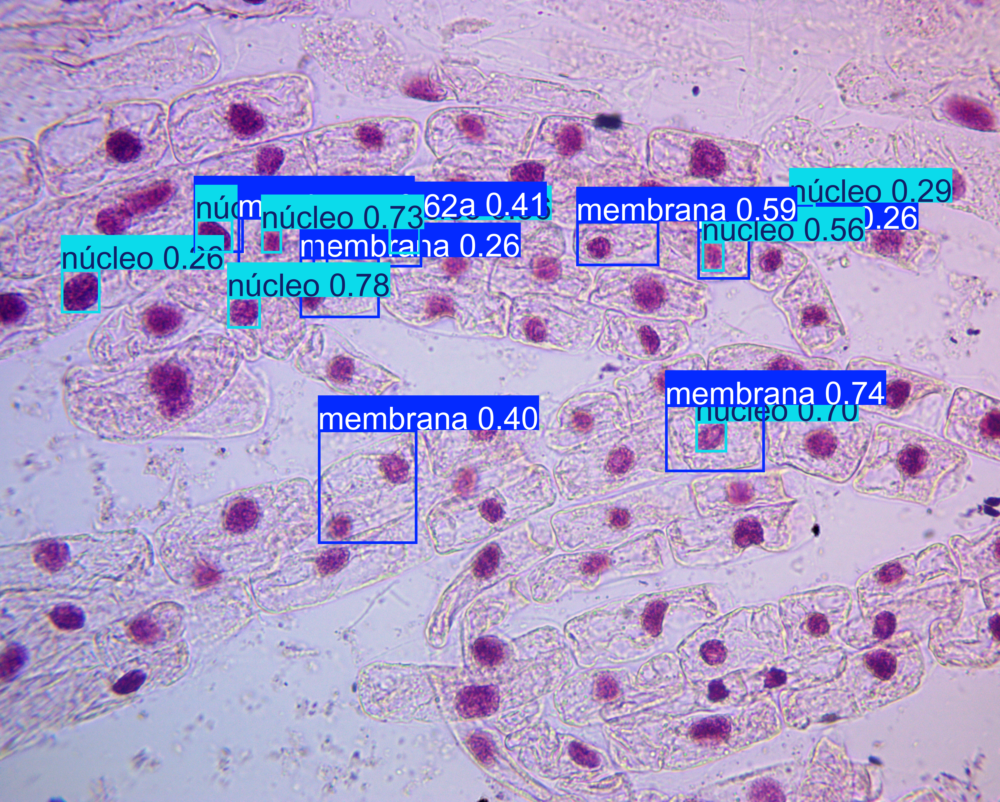

In [49]:
# Hacer la predicción
results = model.predict('/content/drive/My Drive/microscopy/Yolo/img.jpg')

# Mostrar las predicciones
results[0].show()  # Esto debería mostrar la imagen con las detecciones.


In [51]:
# Guardar la imagen con las detecciones
results[0].save()  # Esto guarda la imagen con las detecciones en el directorio de salida

# Mostrar la imagen guardada en el entorno de Google Colab
from PIL import Image
output_image_path = '/content/drive/My Drive/microscopy/Yolo/img.jpg'  # Ajusta este path según el nombre de tu imagen de salida
img = Image.open(output_image_path)
img.show()
